<a href="https://colab.research.google.com/github/Grace-Gitome/Sentimental_Analysis/blob/main/sentimental_analysis_of_tweets.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from pyforest import *



# Data Collection and Preprocessing

In [ ]:
#Loading dataset
df = pd.read_csv('Data/training.1600000.processed.noemoticon.csv', encoding='latin-1')

<IPython.core.display.Javascript object>

In [ ]:
df.head()

,0,1467810369,Mon Apr 06 22:19:45 PDT 2009,NO_QUERY,_TheSpecialOne_,"@switchfoot http://twitpic.com/2y1zl - Awww, that's a bummer. You shoulda got David Carr of Third Day to do it. ;D"
0,0,1467810672,Mon Apr 06 22:19:49 PDT 2009,NO_QUERY,scotthamilton,is upset that he can't update his Facebook by ...
1,0,1467810917,Mon Apr 06 22:19:53 PDT 2009,NO_QUERY,mattycus,@Kenichan I dived many times for the ball. Man...
2,0,1467811184,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,ElleCTF,my whole body feels itchy and like its on fire
3,0,1467811193,Mon Apr 06 22:19:57 PDT 2009,NO_QUERY,Karoli,"@nationwideclass no, it's not behaving at all...."
4,0,1467811372,Mon Apr 06 22:20:00 PDT 2009,NO_QUERY,joy_wolf,@Kwesidei not the whole crew


In [ ]:
#renaming columns
df.columns =['target','id', 'date', 'flag', 'user', 'text']

In [ ]:
#view the column names
df.columns.values

array(['target', 'id', 'date', 'flag', 'user', 'text'], dtype=object)

In [ ]:
df.tail()

,target,id,date,flag,user,text
1599994,4,2193601966,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,AmandaMarie1028,Just woke up. Having no school is the best fee...
1599995,4,2193601969,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,TheWDBoards,TheWDB.com - Very cool to hear old Walt interv...
1599996,4,2193601991,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,bpbabe,Are you ready for your MoJo Makeover? Ask me f...
1599997,4,2193602064,Tue Jun 16 08:40:49 PDT 2009,NO_QUERY,tinydiamondz,Happy 38th Birthday to my boo of alll time!!! ...
1599998,4,2193602129,Tue Jun 16 08:40:50 PDT 2009,NO_QUERY,RyanTrevMorris,happy #charitytuesday @theNSPCC @SparksCharity...


target: the polarity of the tweet (0 = negative, 2 = neutral, 4 = positive)

### Exploratory Data Analysis

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1599999 entries, 0 to 1599998
Data columns (total 6 columns):
 #   Column  Non-Null Count    Dtype 
---  ------  --------------    ----- 
 0   target  1599999 non-null  int64 
 1   id      1599999 non-null  int64 
 2   date    1599999 non-null  object
 3   flag    1599999 non-null  object
 4   user    1599999 non-null  object
 5   text    1599999 non-null  object
dtypes: int64(2), object(4)
memory usage: 73.2+ MB


In [ ]:
df.shape

(1599999, 6)

There are 1599999 rows and 6 columns in the datset

In [ ]:
df.isnull().sum()

target    0
id        0
date      0
flag      0
user      0
text      0
dtype: int64

There are no nulls

In [ ]:
duplicate_rows = df[df.duplicated()]
duplicate_rows

,target,id,date,flag,user,text


There are no duplicates

In [ ]:
#Check number of target variables 
df['target'].nunique()

2

The tweets have been annotated (0 = negative, 4 = positive) and they can be used to detect sentiment .

### Visualization

In [ ]:
import plotly.express as px
px.histogram(df, x="target")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Text(0, 0.5, 'Samples')

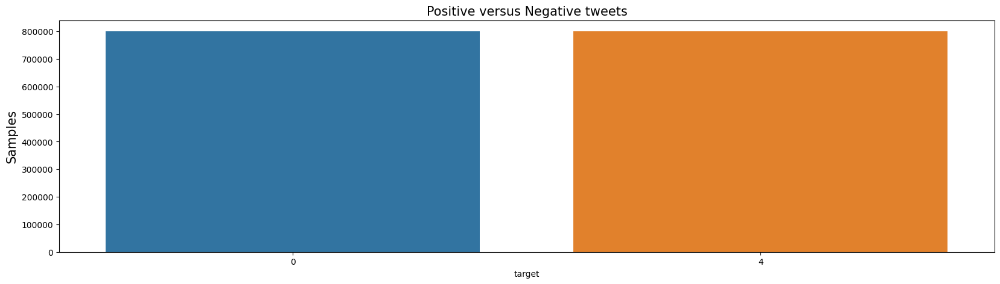

In [ ]:
#Countplot of the tweets
import seaborn as sns
plt.figure(figsize = (20,5))
ax=sns.countplot(x='target', data=df)

plt.title('Positive versus Negative tweets',fontsize=15)
plt.ylabel('Samples',fontsize=15)

### Text Pre-processing

Text data is unstructured in nature.

#### Sentiment classification

1. **Text** - actual review comment. <br>
2. **Target** -the tweets have been annotated (0 = negative, 4 = positive) and they can be used to detect sentiment<br>

Since we are only concerned with columns of unstructured textual tweets and sentiments, the remaining columns are dropped.

In [ ]:
#Dropping the unnecessary columns from the dataset

df1 = df.drop(['id', 'date', 'flag', 'user'],axis = 1)
df1.head(7)

,target,text
0,0,is upset that he can't update his Facebook by ...
1,0,@Kenichan I dived many times for the ball. Man...
2,0,my whole body feels itchy and like its on fire
3,0,"@nationwideclass no, it's not behaving at all...."
4,0,@Kwesidei not the whole crew
5,0,Need a hug
6,0,@LOLTrish hey long time no see! Yes.. Rains a...


### Lowercase all the tweets

The first step is transforming the tweets into lowercase to maintain a consistent flow during the NLP tasks and text mining.<br> 
For example 'Nation' and 'nation' will be treated as two different words in any sentence, and hence, we need to make all the words lowercase in the tweets to avoid duplication while creating our words dictionary.

In [ ]:
df1['text'] = df1 ['text'].str.lower()
df1.head()

,target,text
0,0,is upset that he can't update his facebook by ...
1,0,@kenichan i dived many times for the ball. man...
2,0,my whole body feels itchy and like its on fire
3,0,"@nationwideclass no, it's not behaving at all...."
4,0,@kwesidei not the whole crew


### Remove Hyper-Links
They are very common in tweets and don't add any additional information as per our problem statement of sentiment analysis.

In [ ]:
#Removing hyper-links
df1['text'] = df1['text'].str.replace(r"http:\S+","",regex = True)
df1.head()

,target,text
0,0,is upset that he can't update his facebook by ...
1,0,@kenichan i dived many times for the ball. man...
2,0,my whole body feels itchy and like its on fire
3,0,"@nationwideclass no, it's not behaving at all...."
4,0,@kwesidei not the whole crew


### Remove punctuations
For most NLP problems, punctuations do not provide additional language information and are generally removed.<br>
Similarly, punctuation symbols are not crucial for sentiment analysis. they are redundant are the removal of punctuation before text modelling is highly recommended.

In [ ]:
#Removing punctuations
df1['text'] = df1['text'].str.replace('[^A-Za-z0-9]+', ' ', regex =True)
df1.head()

,target,text
0,0,is upset that he can t update his facebook by ...
1,0,kenichan i dived many times for the ball mana...
2,0,my whole body feels itchy and like its on fire
3,0,nationwideclass no it s not behaving at all i...
4,0,kwesidei not the whole crew


### Remove Stopwords
Stopwords are English words that do not add much meaning to a sentence. They are removed as they do not add value to the analysis.

NLTK library consists of a list of words that are considered stopwords for the English language. Some of them are : [i, me, my, myself, we, our, ours]

In [ ]:
#requirement to remove stopwords

#importing nlp library
import nltk
nltk.download('stopwords')


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\gitom\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [ ]:

#NLTK library provides a set of stopwords for English
from nltk.corpus import stopwords 

#Stopwords present in the library
stopwords = set(stopwords.words('english'))


#Removing stopwords
df1['text'] = df1['text'].apply(lambda words: ' '.join(word.lower() for word in words.split() if word not in stopwords))
df1.head()

,target,text
0,0,upset update facebook texting might cry result...
1,0,kenichan dived many times ball managed save 50...
2,0,whole body feels itchy like fire
3,0,nationwideclass behaving mad see
4,0,kwesidei whole crew


### Tokenization

This refers to splitting up a larger body of text into smaller lines (paragraphs) and words. These broken pieces are called tokens (either word token or sentence tokens)<br><br>

Punkt -a tokenizer that devides a text into a list of sentences using an unsuprevised algorith to build a model for abbreviation words and words that start with sentences.


Below is  random sample code to illustrate tokenization

In [ ]:
#Requirement for tokenization
nltk.download('punkt')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\gitom\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
#importing nlp library
import nltk

string = "What is your favourite food joint?"

tokens = nltk.word_tokenize(string)

print(tokens)

['What', 'is', 'your', 'favourite', 'food', 'joint', '?']


In [ ]:
df2 = df1.copy()

In [ ]:
#defining function for tokenization
#Tokenization of tweets using the TweetTokenizer
from nltk.tokenize import TweetTokenizer
def tokenize(text):
  tknzr = TweetTokenizer(reduce_len=True)
  return tknzr.tokenize(text)

#applying function to the column
df2['tokenized_text']=[tokenize(sentence) for sentence in df2['text']]
df2.head()


,target,text,tokenized_text
0,0,upset update facebook texting might cry result...,"[upset, update, facebook, texting, might, cry,..."
1,0,kenichan dived many times ball managed save 50...,"[kenichan, dived, many, times, ball, managed, ..."
2,0,whole body feels itchy like fire,"[whole, body, feels, itchy, like, fire]"
3,0,nationwideclass behaving mad see,"[nationwideclass, behaving, mad, see]"
4,0,kwesidei whole crew,"[kwesidei, whole, crew]"


### Stemming and Lemmatization

These are text normalization techniques for NLP.

Definition of terms:<br>
WordNet - a large lexical database of English Words.<br>


WhitespaceTokenizer()- this method breaks texts into terms whenever it encounters a whitespace character.<br><br>
WordNetLemmatizer() - lemmatize a word on its context usage within the sentence

In [ ]:
# wordnet lemmatizer
import nltk
nltk.download('punkt')
nltk.download('wordnet')


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\gitom\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\gitom\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [ ]:
#Lemmatization of tokens
from nltk.stem import WordNetLemmatizer

lemmatizer =WordNetLemmatizer()
def lemmatizing(tokens):  
    return [lemmatizer.lemmatize(t) for t in tokens]
df2['lemmatized_tokens']= df2['tokenized_text'].apply(lambda x: lemmatizing(x)) 


In [ ]:
df2.head()

,target,text,tokenized_text,lemmatized_tokens
0,0,upset update facebook texting might cry result...,"[upset, update, facebook, texting, might, cry,...","[upset, update, facebook, texting, might, cry,..."
1,0,kenichan dived many times ball managed save 50...,"[kenichan, dived, many, times, ball, managed, ...","[kenichan, dived, many, time, ball, managed, s..."
2,0,whole body feels itchy like fire,"[whole, body, feels, itchy, like, fire]","[whole, body, feel, itchy, like, fire]"
3,0,nationwideclass behaving mad see,"[nationwideclass, behaving, mad, see]","[nationwideclass, behaving, mad, see]"
4,0,kwesidei whole crew,"[kwesidei, whole, crew]","[kwesidei, whole, crew]"


## Text Exploratory Analysis

In [ ]:
df3 = df2.copy()

In [ ]:
df3 = df3.drop('tokenized_text', axis= 1)
df3.head()

,target,text,lemmatized_tokens
0,0,upset update facebook texting might cry result...,"[upset, update, facebook, texting, might, cry,..."
1,0,kenichan dived many times ball managed save 50...,"[kenichan, dived, many, time, ball, managed, s..."
2,0,whole body feels itchy like fire,"[whole, body, feel, itchy, like, fire]"
3,0,nationwideclass behaving mad see,"[nationwideclass, behaving, mad, see]"
4,0,kwesidei whole crew,"[kwesidei, whole, crew]"


In [ ]:
#Analyzing text length for different sentiments
df3['word_length'] =df3['text'].str.split().str.len()
df3.head()

,target,text,lemmatized_tokens,word_length
0,0,upset update facebook texting might cry result...,"[upset, update, facebook, texting, might, cry,...",11
1,0,kenichan dived many times ball managed save 50...,"[kenichan, dived, many, time, ball, managed, s...",11
2,0,whole body feels itchy like fire,"[whole, body, feel, itchy, like, fire]",6
3,0,nationwideclass behaving mad see,"[nationwideclass, behaving, mad, see]",4
4,0,kwesidei whole crew,"[kwesidei, whole, crew]",3


#### WordCloud

NOTE:<br>
Code to install wordcloud for python 3.11<br>
python -m pip install -e git+https://github.com/amueller/word_cloud#egg=wordcloud

In [ ]:
from wordcloud import WordCloud

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

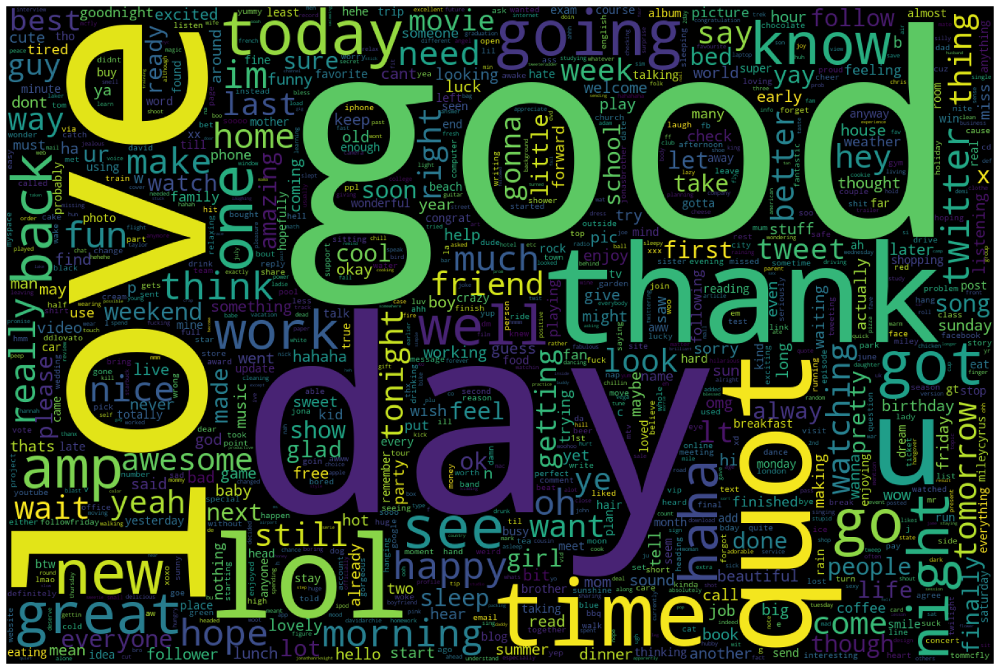

In [ ]:
#WordCloud for positive sentiments from the tweets dataset
positive_sentiments = df3[df3['target']==4]['text']
wc = WordCloud(max_words = 1000 ,
               width = 1200 ,
               height = 800,
               collocations=False).generate(" ".join(positive_sentiments))
plt.figure(figsize = (20,20))
plt.axis('off')
plt.imshow(wc);

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

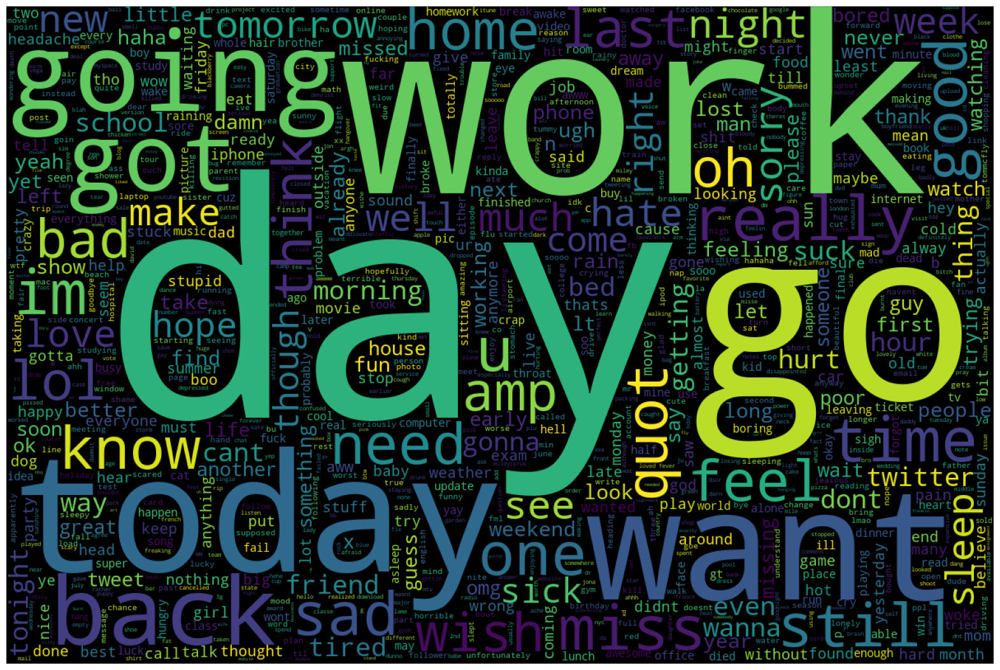

In [ ]:
#WordCloud for negative sentiments from the tweets dataset
negative_sentiments = df3[df3['target']==0]['text']
wc = WordCloud(max_words = 1000 ,
               width = 1200 ,
               height = 800,
               collocations=False).generate(" ".join(negative_sentiments))
plt.figure(figsize = (20,20))
plt.axis('off')
plt.imshow(wc);

# Model Development

ML<br>
**Supervised Learning** <br>
1. Classification<br>
2. Regression<br>

**Unsupervised Learning**


### Importing necessary libraries

In [ ]:
#Importing necessary libraries
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.svm import LinearSVC
from sklearn.naive_bayes import BernoulliNB
from sklearn.linear_model import LogisticRegression
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import confusion_matrix, classification_report

In [ ]:
df3.shape

(1599999, 4)

### Splitting the dataset into train and test subsets

test size = 0.03 ; 30% <br>
random_state - ensures that the results are reproducible.<br>
random_state = None, we ger different train and test sets across different executions and the shuffling process is out of control.<br><br>
random_state = 0, we get same train and test sets across different executions.
<br><br>
random_state = 42, we get the same train and test sets across different excecutions but in this time, the train and test sets are different from the previous case with random_state =0
<br><br>

stratify - random sampling that enables one to obtain a sample population that best represents the entire population being studied, making sure that each subgroup of interest is represented.